# ENDOMETRIOSIS DETECTION WITH SSD_MOBILENET MODEL

## IMPORT THE REQUIRED LIBARIES

In [2]:
import tensorflow as tf
print("Tensor version" + tf.__version__)
print(tf.config.list_physical_devices('GPU'))

import json
import shutil
import os
from sklearn.model_selection import train_test_split
import imgaug.augmenters as iaa
import imgaug as ia
import imageio
from imgaug.augmentables.bbs import BoundingBox, BoundingBoxesOnImage

from object_detection.utils import dataset_util, label_map_util
from object_detection.dataset_tools import create_coco_tf_record
from object_detection.dataset_tools import tf_record_creation_util
from object_detection.dataset_tools import create_coco_tf_record

import pathlib
import matplotlib
import matplotlib.pyplot as plt

import random
import tarfile
import io
import glob
import scipy.misc
import numpy as np
from six import BytesIO
from PIL import Image, ImageDraw, ImageFont
from IPython.display import display, Javascript
from IPython.display import Image as IPyImage

from object_detection.utils import config_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder

%matplotlib inline
import matplotlib.patches as patches
import re
from PIL import Image

Tensor version2.13.1
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [3]:
# Compiling the model's architecture
MODELS_CONFIG = {
    'mobilenet': {
        'model_name': 'ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8',
        'base_pipeline_file': 'ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.config',
        'pretrained_checkpoint': 'ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz',
        'batch_size': 64
    },
}

chosen_model = 'mobilenet'
num_steps = 65000 # The number of steps to train for. The more steps, the longer the training
num_eval_steps = 500 #Perform evaluation after so many steps

model_name = MODELS_CONFIG[chosen_model]['model_name']
pretrained_checkpoint = MODELS_CONFIG[chosen_model]['pretrained_checkpoint']
base_pipeline_file = MODELS_CONFIG[chosen_model]['base_pipeline_file']
batch_size = MODELS_CONFIG[chosen_model]['batch_size'] 

In [4]:
%cd '/home/759635/models/research/deploy/'
download_tar = 'http://download.tensorflow.org/models/object_detection/tf2/20200711/' + pretrained_checkpoint

!wget {download_tar}
tar = tarfile.open(pretrained_checkpoint)
tar.extractall()
tar.close()

/home/759635/models/research/deploy
--2023-12-31 15:01:31--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 142.250.200.27, 216.58.201.123, 216.58.204.91, ...
Connecting to download.tensorflow.org (download.tensorflow.org)|142.250.200.27|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 20518283 (20M) [application/x-tar]
Saving to: 'ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz'

100%[======================================>] 20,518,283  28.9MB/s   in 0.7s   

2023-12-31 15:01:32 (28.9 MB/s) - 'ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.tar.gz' saved [20518283/20518283]



In [6]:
#download base training configuration file
%cd /home/759635/models/research/deploy
download_config = 'https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/' + base_pipeline_file
!wget {download_config}

/home/759635/models/research/deploy
--2023-12-31 15:02:07--  https://raw.githubusercontent.com/tensorflow/models/master/research/object_detection/configs/tf2/ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.config
Resolving raw.githubusercontent.com (raw.githubusercontent.com)... 185.199.110.133, 185.199.109.133, 185.199.111.133, ...
Connecting to raw.githubusercontent.com (raw.githubusercontent.com)|185.199.110.133|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4684 (4.6K) [text/plain]
Saving to: 'ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.config'

100%[======================================>] 4,684       --.-K/s   in 0.06s   

2023-12-31 15:02:07 (81.7 KB/s) - 'ssd_mobilenet_v2_fpnlite_640x640_coco17_tpu-8.config' saved [4684/4684]



In [4]:
#File paths for the pipeline configuration and fine-tune checkpoint
pipeline_fname = '/home/759635/models/research/deploy/' + base_pipeline_file
fine_tune_checkpoint_mobilenet = '/home/759635/models/research/deploy/' + model_name + '/checkpoint/ckpt-0'
label_map_file = '/home/759635/Glenda_v1.5_classes/label_map.pbtxt'

# Function to get the number of classes from the label map file
def get_num_classes(pbtxt_fname):
    from object_detection.utils import label_map_util
    label_map = label_map_util.load_labelmap(pbtxt_fname)
    categories = label_map_util.convert_label_map_to_categories(
        label_map, max_num_classes=90, use_display_name=True)
    category_index = label_map_util.create_category_index(categories)
    return len(category_index.keys())
num_classes = get_num_classes(label_map_file)

In [5]:
'''
writing the custom configuration file by slotting the dataset, model checkpoint, and training parameters into the 
base pipeline file using regular expression

'''
train_record_pattern = '/home/759635/Glenda_v1.5_classes/tfrecords/train.record-*'
test_record_pattern = '/home/759635/Glenda_v1.5_classes/tfrecords/test.record-*'

print('writing custom configuration file')

with open(pipeline_fname) as f:
    s = f.read()

# Path for the sharded TFRecord files (use wildcard)
train_record_fname = train_record_pattern
test_record_fname = test_record_pattern

with open('pipeline_file.config', 'w') as f:
    # Replace fine_tune_checkpoint
    s = re.sub('fine_tune_checkpoint: ".*?"',
               'fine_tune_checkpoint: "{}"'.format(fine_tune_checkpoint_mobilenet), s)

    # Replace tfrecord files train and test with wildcard paths.
    s = re.sub('input_path: ".*?train.*?"', 'input_path: "{}"'.format(train_record_fname), s)
    s = re.sub('input_path: ".*?val.*?"', 'input_path: "{}"'.format(test_record_fname), s)

    # Replace label_map_path
    s = re.sub('label_map_path: ".*?"', 'label_map_path: "{}"'.format(label_map_file), s)

    # Set training batch_size.
    s = re.sub('batch_size: [0-9]+', 'batch_size: {}'.format(batch_size), s)

    # Set training steps, num_steps
    s = re.sub('num_steps: [0-9]+', 'num_steps: {}'.format(num_steps), s)

    # Set number of classes num_classes.
    s = re.sub('num_classes: [0-9]+', 'num_classes: {}'.format(num_classes), s)

    # Set fine-tune checkpoint type
    s = re.sub('fine_tune_checkpoint_type: ".*?"', 'fine_tune_checkpoint_type: "detection"', s)

    f.write(s)

writing custom configuration file


In [6]:
#Display the contents of the pipeline file
%cat /home/759635/models/research/deploy/pipeline_file.config

# SSD with Mobilenet v2 FPN-lite (go/fpn-lite) feature extractor, shared box
# predictor and focal loss (a mobile version of Retinanet).
# Retinanet: see Lin et al, https://arxiv.org/abs/1708.02002
# Trained on COCO, initialized from Imagenet classification checkpoint
# Train on TPU-8
#
# Achieves 28.2 mAP on COCO17 Val

model {
  ssd {
    inplace_batchnorm_update: true
    freeze_batchnorm: false
    num_classes: 4
    box_coder {
      faster_rcnn_box_coder {
        y_scale: 10.0
        x_scale: 10.0
        height_scale: 5.0
        width_scale: 5.0
      }
    }
    matcher {
      argmax_matcher {
        matched_threshold: 0.5
        unmatched_threshold: 0.5
        ignore_thresholds: false
        negatives_lower_than_unmatched: true
        force_match_for_each_row: true
        use_matmul_gather: true
      }
    }
    similarity_calculator {
      iou_similarity {
      }
    }
    encode_background_as_zeros: true
    anchor_generator {
      multiscale_anchor_generator {

In [7]:
# File path for the model training pipeline configuration
pipeline_file = '/home/759635/models/research/deploy/pipeline_file.config'

# Directory path where the trained model or model checkpoints will be saved
model_dir = '/home/759635/training_mobilenet/'

### Model Training 

In [8]:
!python /home/759635/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --alsologtostderr \
    --num_train_steps={num_steps} \
    --sample_1_of_n_eval_examples=1 \
    --num_eval_steps={num_eval_steps}

2024-01-02 06:40:36.433517: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-02 06:40:38.373164: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2024-01-02 06:40:47.417236: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1639] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43411 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:02:00.0, compute capability: 8.6
INFO:tensorflow:Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
I0102 06:40:47.423841 140635624269632 mirrored_strategy.py:419] Using MirroredStrategy with devices ('/job:localhost/replica:0/task:0/device:GPU:0',)
INFO:tensorflow:Maybe overwriting train_steps: 65000
I0102 06:

INFO:tensorflow:Step 60100 per-step time 3.612s
I0102 06:48:05.383588 140635624269632 model_lib_v2.py:705] Step 60100 per-step time 3.612s
INFO:tensorflow:{'Loss/classification_loss': 0.010559182,
 'Loss/localization_loss': 0.001164835,
 'Loss/regularization_loss': 0.03995751,
 'Loss/total_loss': 0.051681526,
 'learning_rate': 0.0}
I0102 06:48:05.384648 140635624269632 model_lib_v2.py:708] {'Loss/classification_loss': 0.010559182,
 'Loss/localization_loss': 0.001164835,
 'Loss/regularization_loss': 0.03995751,
 'Loss/total_loss': 0.051681526,
 'learning_rate': 0.0}
INFO:tensorflow:Step 60200 per-step time 2.506s
I0102 06:52:15.772251 140635624269632 model_lib_v2.py:705] Step 60200 per-step time 2.506s
INFO:tensorflow:{'Loss/classification_loss': 0.011369737,
 'Loss/localization_loss': 0.0012654201,
 'Loss/regularization_loss': 0.03995751,
 'Loss/total_loss': 0.052592665,
 'learning_rate': 0.0}
I0102 06:52:15.772993 140635624269632 model_lib_v2.py:708] {'Loss/classification_loss': 0.011

INFO:tensorflow:Step 61100 per-step time 2.517s
I0102 07:29:59.980384 140635624269632 model_lib_v2.py:705] Step 61100 per-step time 2.517s
INFO:tensorflow:{'Loss/classification_loss': 0.01309804,
 'Loss/localization_loss': 0.0015556774,
 'Loss/regularization_loss': 0.03995751,
 'Loss/total_loss': 0.054611225,
 'learning_rate': 0.0}
I0102 07:29:59.981031 140635624269632 model_lib_v2.py:708] {'Loss/classification_loss': 0.01309804,
 'Loss/localization_loss': 0.0015556774,
 'Loss/regularization_loss': 0.03995751,
 'Loss/total_loss': 0.054611225,
 'learning_rate': 0.0}
INFO:tensorflow:Step 61200 per-step time 2.507s
I0102 07:34:10.654227 140635624269632 model_lib_v2.py:705] Step 61200 per-step time 2.507s
INFO:tensorflow:{'Loss/classification_loss': 0.0123450495,
 'Loss/localization_loss': 0.0010973066,
 'Loss/regularization_loss': 0.03995751,
 'Loss/total_loss': 0.053399865,
 'learning_rate': 0.0}
I0102 07:34:10.654856 140635624269632 model_lib_v2.py:708] {'Loss/classification_loss': 0.01

INFO:tensorflow:Step 62600 per-step time 2.545s
I0102 08:33:03.680060 140635624269632 model_lib_v2.py:705] Step 62600 per-step time 2.545s
INFO:tensorflow:{'Loss/classification_loss': 0.012209836,
 'Loss/localization_loss': 0.0011664925,
 'Loss/regularization_loss': 0.03995751,
 'Loss/total_loss': 0.053333838,
 'learning_rate': 0.0}
I0102 08:33:03.680672 140635624269632 model_lib_v2.py:708] {'Loss/classification_loss': 0.012209836,
 'Loss/localization_loss': 0.0011664925,
 'Loss/regularization_loss': 0.03995751,
 'Loss/total_loss': 0.053333838,
 'learning_rate': 0.0}
INFO:tensorflow:Step 62700 per-step time 2.517s
I0102 08:37:15.378247 140635624269632 model_lib_v2.py:705] Step 62700 per-step time 2.517s
INFO:tensorflow:{'Loss/classification_loss': 0.0116975615,
 'Loss/localization_loss': 0.0010304052,
 'Loss/regularization_loss': 0.03995751,
 'Loss/total_loss': 0.052685473,
 'learning_rate': 0.0}
I0102 08:37:15.378858 140635624269632 model_lib_v2.py:708] {'Loss/classification_loss': 0.

INFO:tensorflow:Step 64100 per-step time 2.508s
I0102 09:35:58.456280 140635624269632 model_lib_v2.py:705] Step 64100 per-step time 2.508s
INFO:tensorflow:{'Loss/classification_loss': 0.011761455,
 'Loss/localization_loss': 0.0010967334,
 'Loss/regularization_loss': 0.03995751,
 'Loss/total_loss': 0.052815698,
 'learning_rate': 0.0}
I0102 09:35:58.456918 140635624269632 model_lib_v2.py:708] {'Loss/classification_loss': 0.011761455,
 'Loss/localization_loss': 0.0010967334,
 'Loss/regularization_loss': 0.03995751,
 'Loss/total_loss': 0.052815698,
 'learning_rate': 0.0}
INFO:tensorflow:Step 64200 per-step time 2.500s
I0102 09:40:08.446507 140635624269632 model_lib_v2.py:705] Step 64200 per-step time 2.500s
INFO:tensorflow:{'Loss/classification_loss': 0.012525047,
 'Loss/localization_loss': 0.001396857,
 'Loss/regularization_loss': 0.03995751,
 'Loss/total_loss': 0.053879414,
 'learning_rate': 0.0}
I0102 09:40:08.447176 140635624269632 model_lib_v2.py:708] {'Loss/classification_loss': 0.01

#### THE MODEL PERFORMANCE METRICS

In [9]:
#run model evaluation to obtain performance metrics
!python /home/759635/models/research/object_detection/model_main_tf2.py \
    --pipeline_config_path={pipeline_file} \
    --model_dir={model_dir} \
    --checkpoint_dir={model_dir} \

2024-01-02 10:14:08.588990: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-02 10:14:32.884365: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
W0102 10:15:23.911033 139804353500992 model_lib_v2.py:1089] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0102 10:15:23.911378 139804353500992 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0102 10:15:23.911452 139804353500992 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0102 10:15:23.911515 139804353500992 config_util.py:552] Maybe o

INFO:tensorflow:Performing evaluation on 38 images.
I0102 10:16:07.434369 139804353500992 coco_evaluation.py:293] Performing evaluation on 38 images.
creating index...
index created!
INFO:tensorflow:Loading and preparing annotation results...
I0102 10:16:07.435371 139804353500992 coco_tools.py:116] Loading and preparing annotation results...
INFO:tensorflow:DONE (t=0.00s)
I0102 10:16:07.438041 139804353500992 coco_tools.py:138] DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.11s).
Accumulating evaluation results...
DONE (t=0.05s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.154
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.226
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.135
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.062
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100

In [10]:
#see where the model saved weights
%ls '/home/759635/training_mobilenet/'

checkpoint                   ckpt-64.data-00000-of-00001
ckpt-60.data-00000-of-00001  ckpt-64.index
ckpt-60.index                ckpt-65.data-00000-of-00001
ckpt-61.data-00000-of-00001  ckpt-65.index
ckpt-61.index                ckpt-66.data-00000-of-00001
ckpt-62.data-00000-of-00001  ckpt-66.index
ckpt-62.index                eval/
ckpt-63.data-00000-of-00001  train/
ckpt-63.index


In [11]:
output_directory = '/home/759635/fine_tuned_model_mobilenet'

#exporting the trained model for inference
last_model_path = '/home/759635/training_mobilenet/'
print(last_model_path)
!python /home/759635/models/research/object_detection/exporter_main_v2.py \
    --trained_checkpoint_dir {last_model_path} \
    --output_directory {output_directory} \
    --pipeline_config_path {pipeline_file}

/home/759635/training_mobilenet/
2024-01-02 10:18:00.350564: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-02 10:18:02.645328: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
2024-01-02 10:18:08.174651: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1639] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43411 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:02:00.0, compute capability: 8.6
Instructions for updating:
back_prop=False is deprecated. Consider using tf.stop_gradient instead.
Instead of:
results = tf.map_fn(fn, elems, back_prop=False)
Use:
results = tf.nest.map_structure(tf.stop_gradient, tf.map_fn(fn, elems))
W0102 10:18:08.790002 140381929051968 depreca

I0102 10:18:40.104266 140381929051968 save.py:274] Found untraced functions such as WeightSharedConvolutionalBoxPredictor_layer_call_fn, WeightSharedConvolutionalBoxPredictor_layer_call_and_return_conditional_losses, WeightSharedConvolutionalBoxHead_layer_call_fn, WeightSharedConvolutionalBoxHead_layer_call_and_return_conditional_losses, WeightSharedConvolutionalClassHead_layer_call_fn while saving (showing 5 of 173). These functions will not be directly callable after loading.
INFO:tensorflow:Assets written to: /home/759635/fine_tuned_model_mobilenet/saved_model/assets
I0102 10:18:45.936858 140381929051968 builder_impl.py:804] Assets written to: /home/759635/fine_tuned_model_mobilenet/saved_model/assets
I0102 10:18:46.231418 140381929051968 fingerprinting_utils.py:48] Writing fingerprint to /home/759635/fine_tuned_model_mobilenet/saved_model/fingerprint.pb
INFO:tensorflow:Writing pipeline config file to /home/759635/fine_tuned_model_mobilenet/pipeline.config
I0102 10:18:46.893896 1403

# Run Inference on Test Images with Custom TensorFlow2 Object Detector

In [12]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: the file path to the image

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [13]:
filenames = list(pathlib.Path('/home/759635/training_mobilenet/').glob('*.index'))

filenames.sort()
print(filenames)

#recover the saved model
pipeline_config = pipeline_file

model_dir = str(filenames[-1]).replace('.index','')
configs = config_util.get_configs_from_pipeline_file(pipeline_config)
model_config = configs['model']
detection_model = model_builder.build(
      model_config=model_config, is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(
      model=detection_model)
ckpt.restore(os.path.join(str(filenames[-1]).replace('.index','')))


def get_model_detection_function(model):
  """Get a tf.function for detection."""

  @tf.function
  def detect_fn(image):
    """Detect objects in image."""

    image, shapes = model.preprocess(image)
    prediction_dict = model.predict(image, shapes)
    detections = model.postprocess(prediction_dict, shapes)

    return detections, prediction_dict, tf.reshape(shapes, [-1])

  return detect_fn

detect_fn = get_model_detection_function(detection_model)

[PosixPath('/home/759635/training_mobilenet/ckpt-60.index'), PosixPath('/home/759635/training_mobilenet/ckpt-61.index'), PosixPath('/home/759635/training_mobilenet/ckpt-62.index'), PosixPath('/home/759635/training_mobilenet/ckpt-63.index'), PosixPath('/home/759635/training_mobilenet/ckpt-64.index'), PosixPath('/home/759635/training_mobilenet/ckpt-65.index'), PosixPath('/home/759635/training_mobilenet/ckpt-66.index')]


2024-01-02 10:19:02.600955: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1639] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 43411 MB memory:  -> device: 0, name: NVIDIA A40, pci bus id: 0000:02:00.0, compute capability: 8.6


In [14]:
'''
This code loads and processes a label map file for inference decoding. Then create a dictionary (`label_map_dict`) 
that maps label names to category information for easy interpretation of model results.
'''
label_map_path = configs['eval_input_config'].label_map_path
label_map = label_map_util.load_labelmap(label_map_path)
categories = label_map_util.convert_label_map_to_categories(
    label_map,
    max_num_classes=label_map_util.get_max_label_map_index(label_map),
    use_display_name=True)
category_index = label_map_util.create_category_index(categories)
label_map_dict = label_map_util.get_label_map_dict(label_map, use_display_name=True)

2024-01-02 10:20:15.071311: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8800
2024-01-02 10:20:16.844156: I tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:606] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


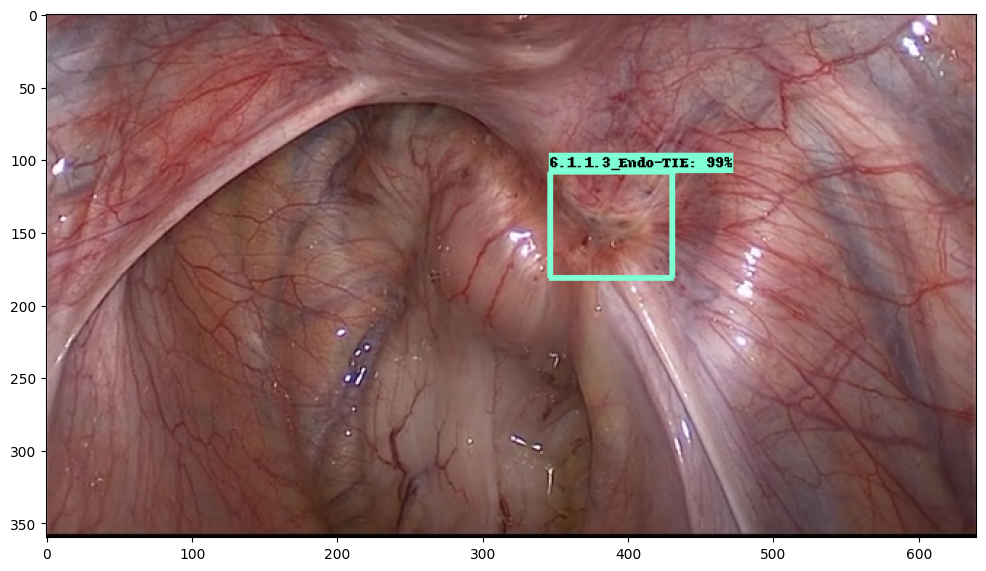

In [15]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('1_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


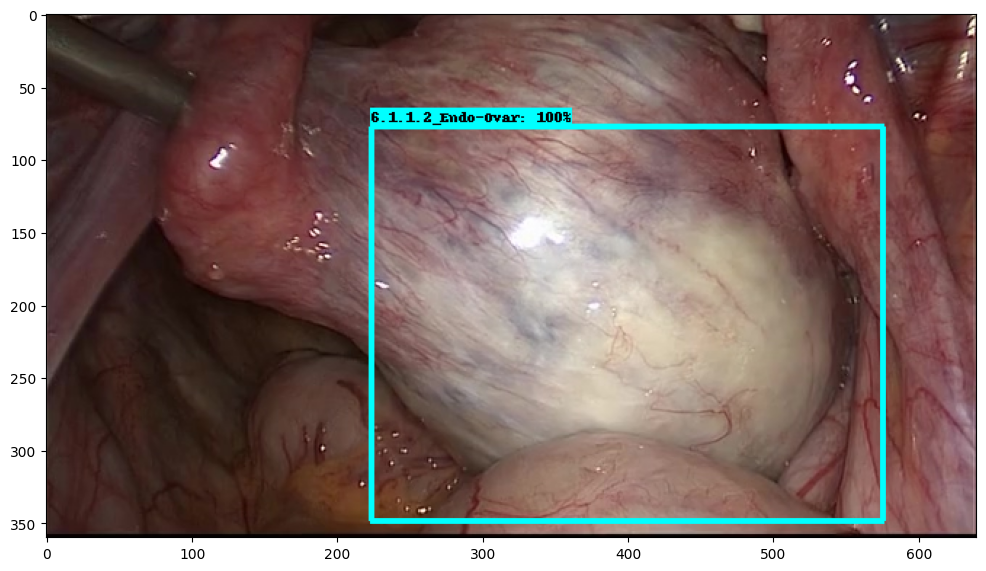

In [21]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('2_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


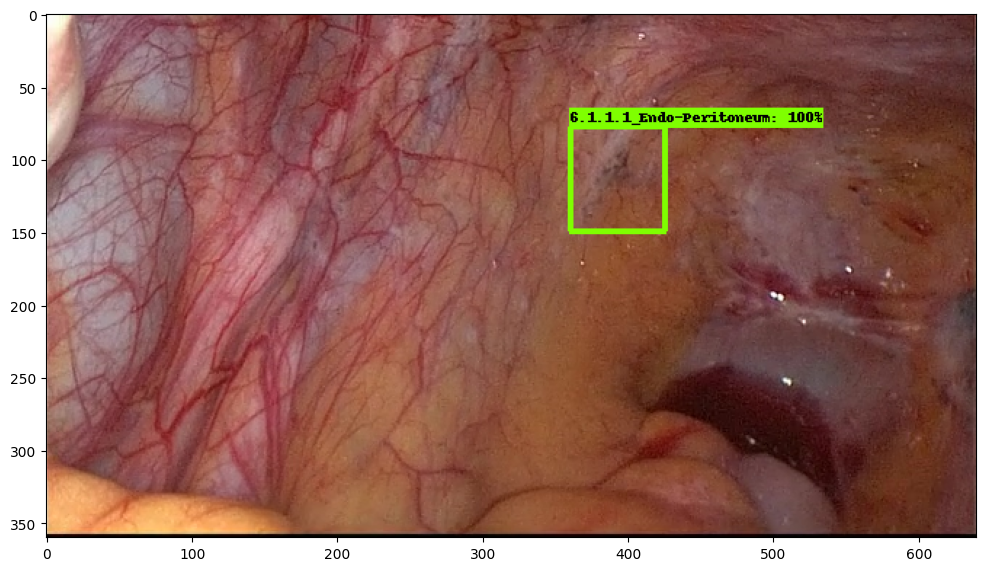

In [26]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('3_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


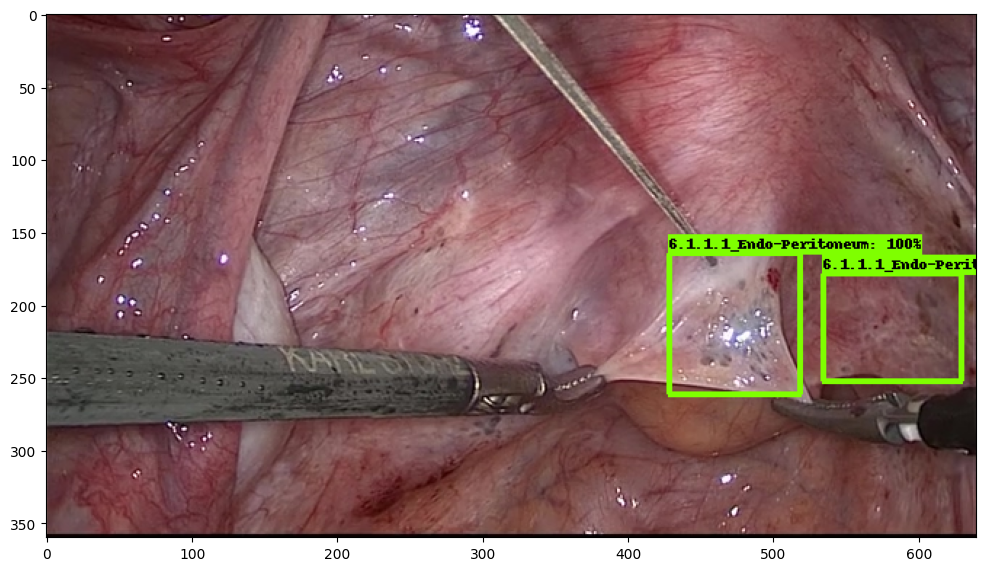

In [28]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('4_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


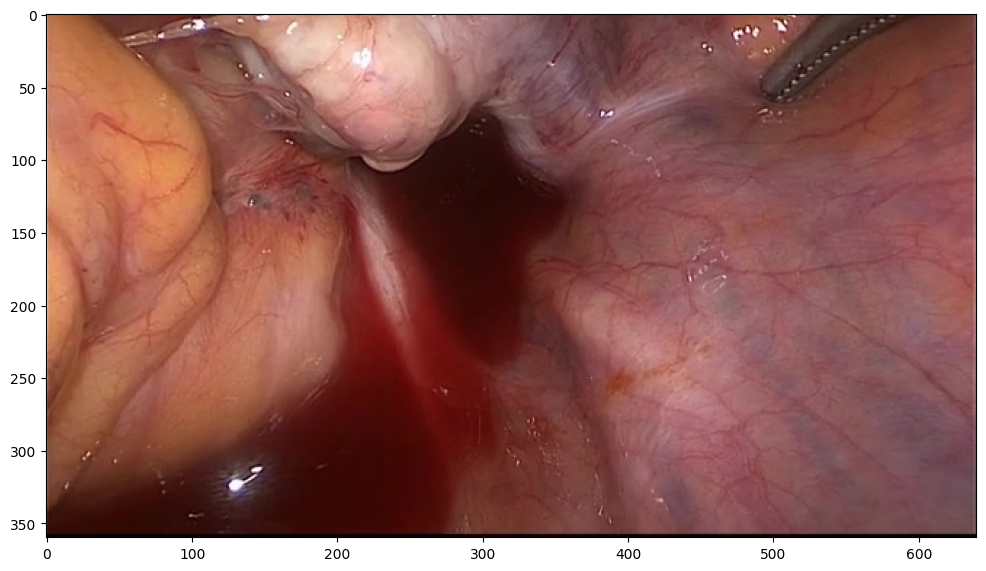

In [30]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('5_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


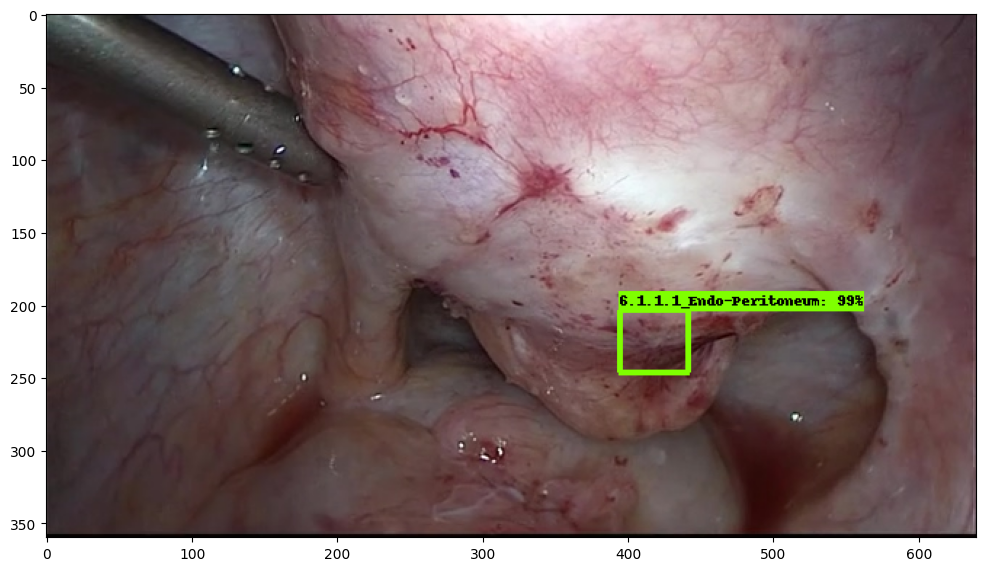

In [33]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('6_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


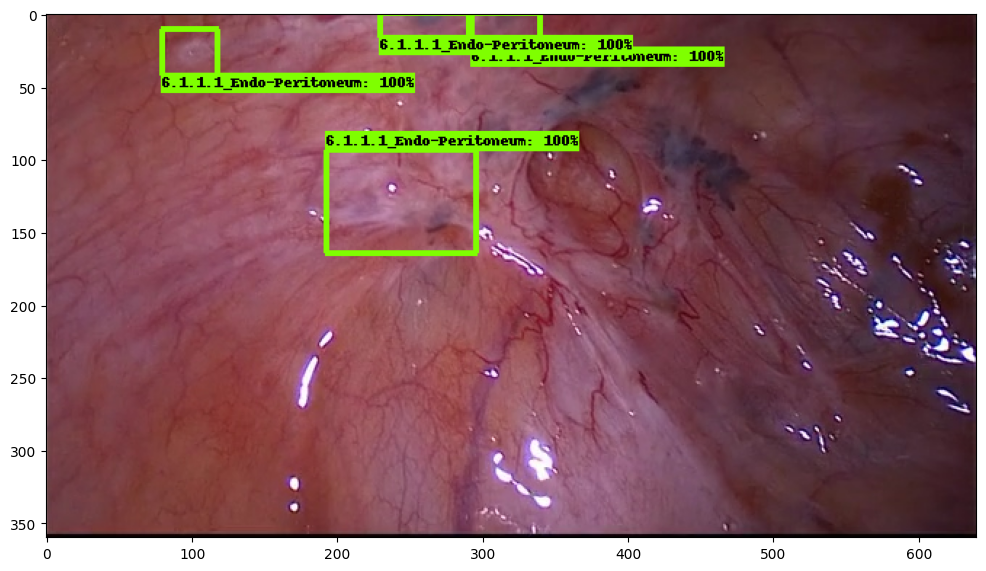

In [34]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('7_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


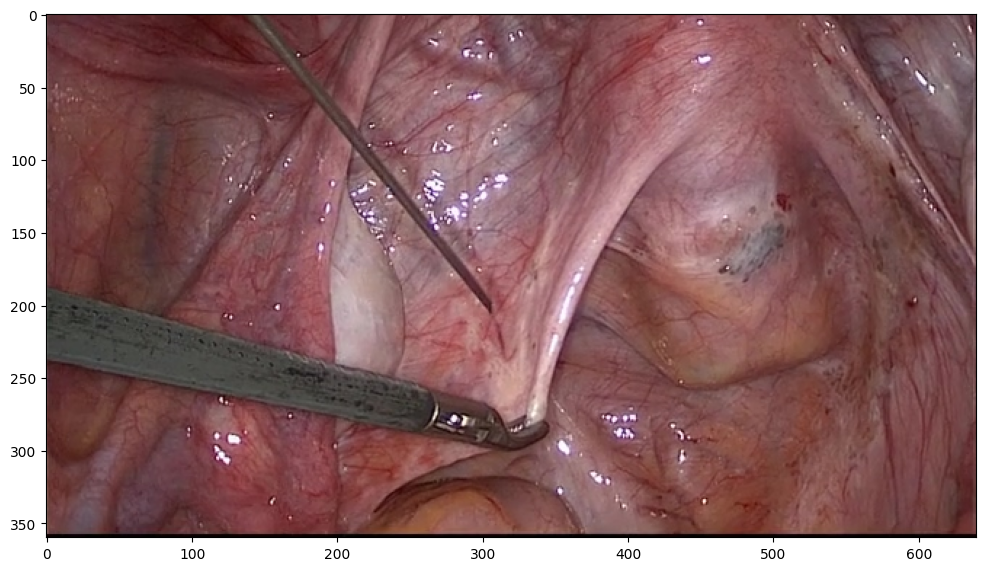

In [35]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('8_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


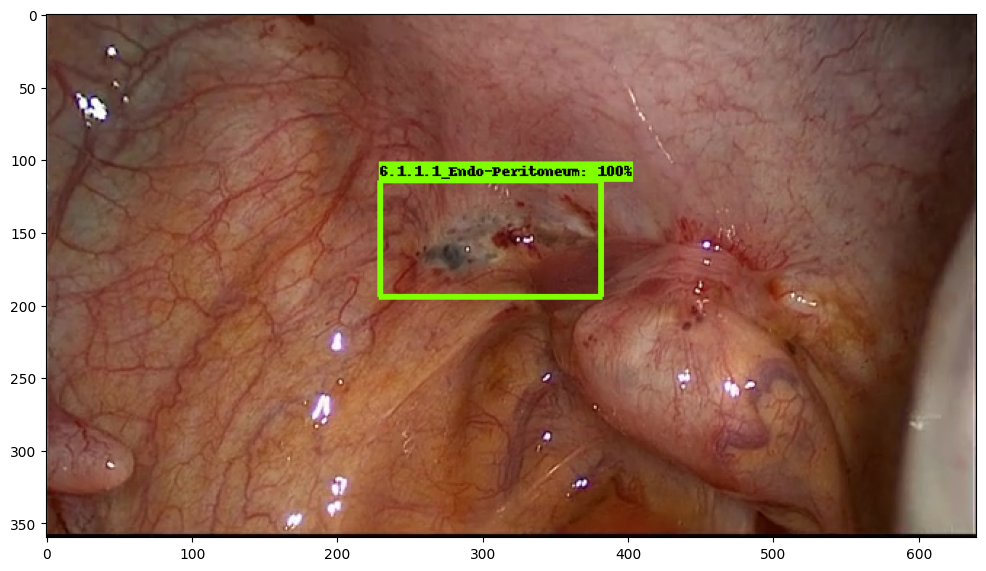

In [56]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('9_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


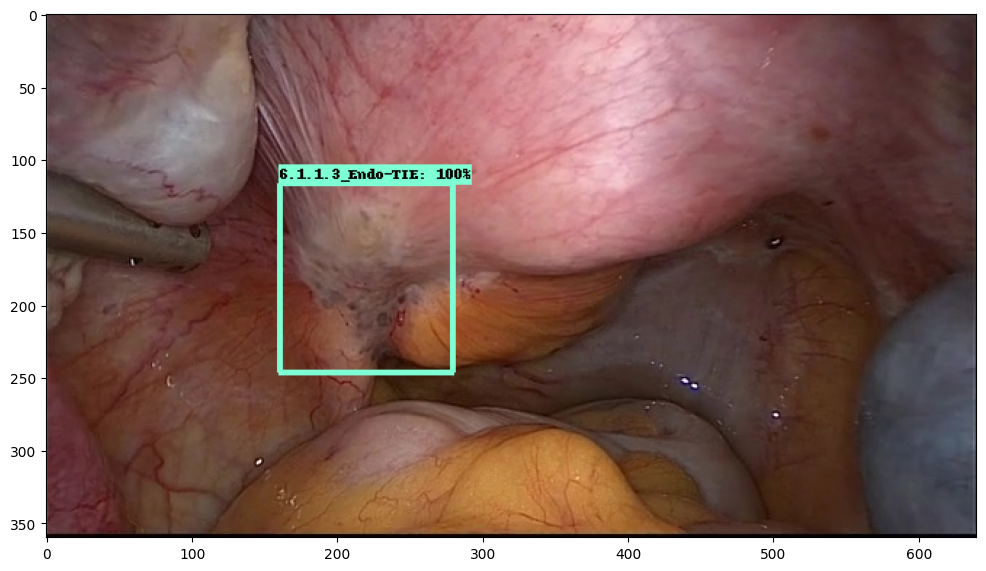

In [40]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('10_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


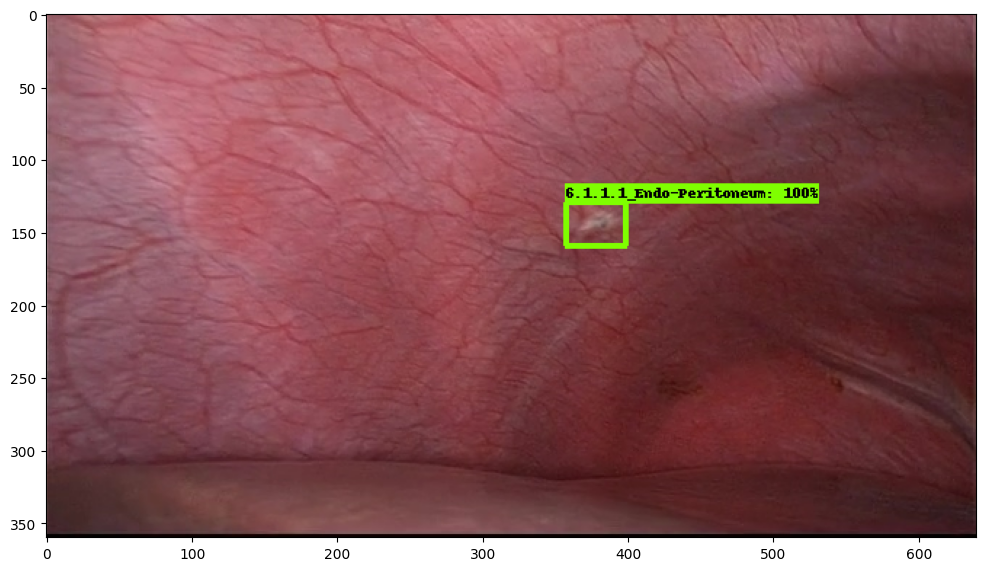

In [42]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('11_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


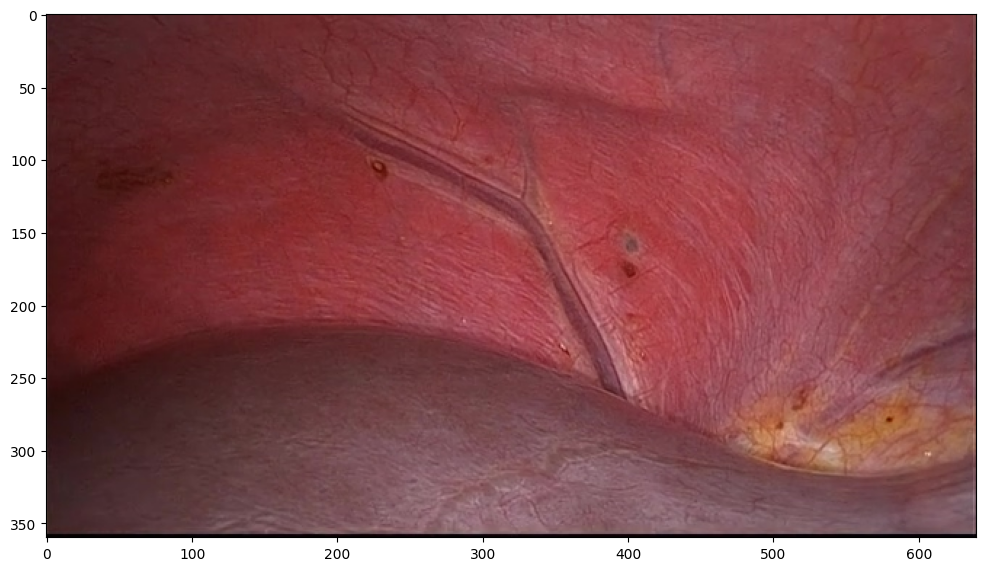

In [43]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('12_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


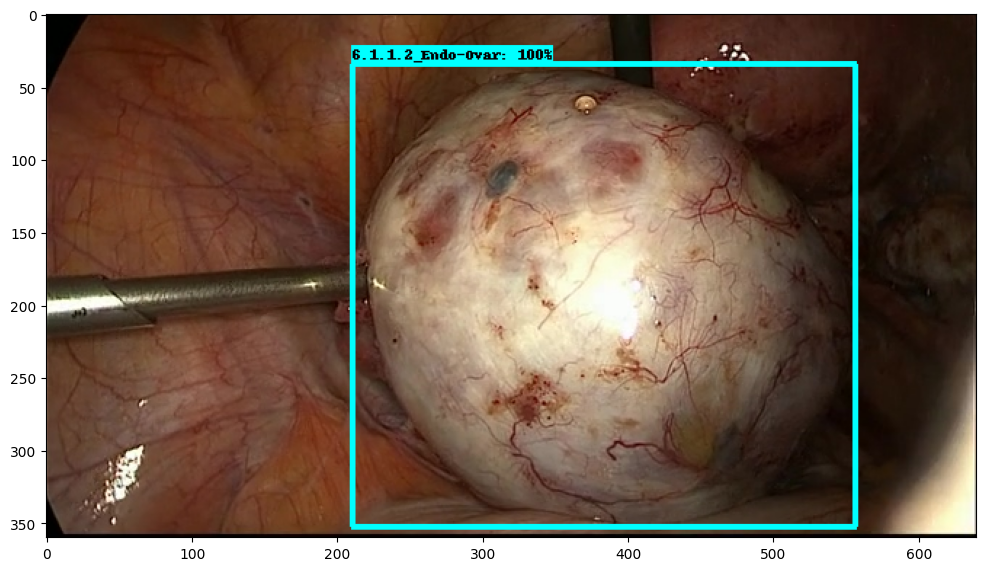

In [46]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('13_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


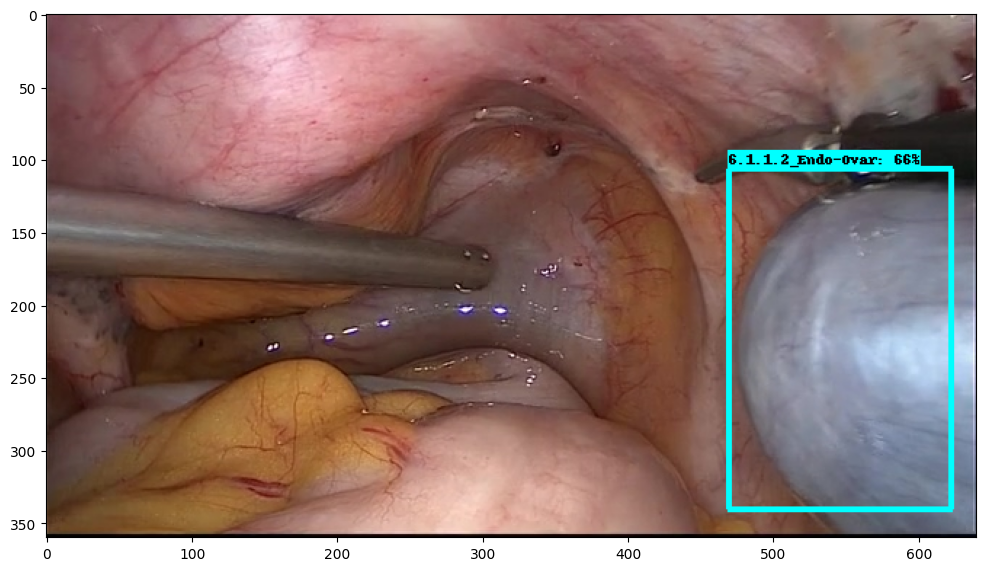

In [45]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('14_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


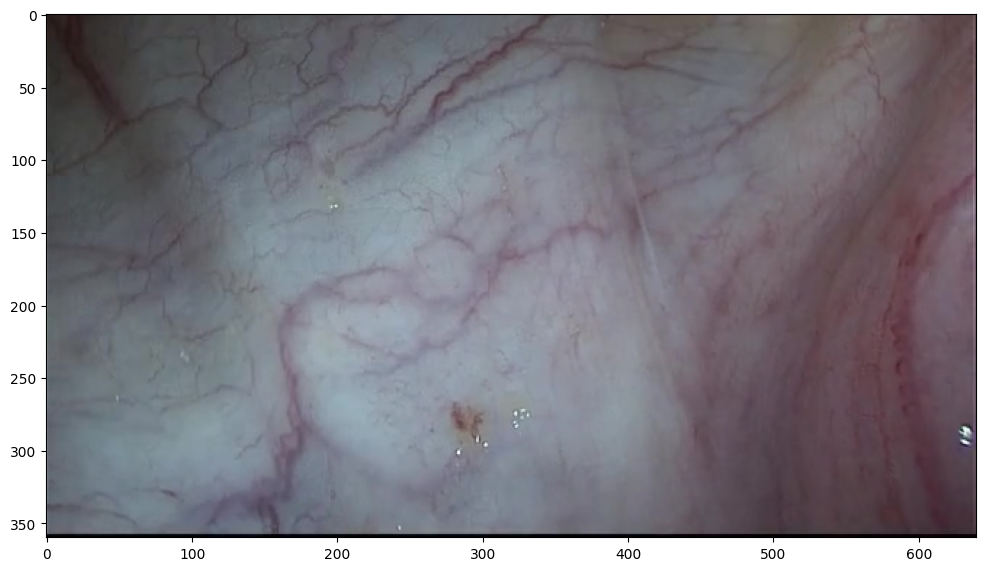

In [50]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('15_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


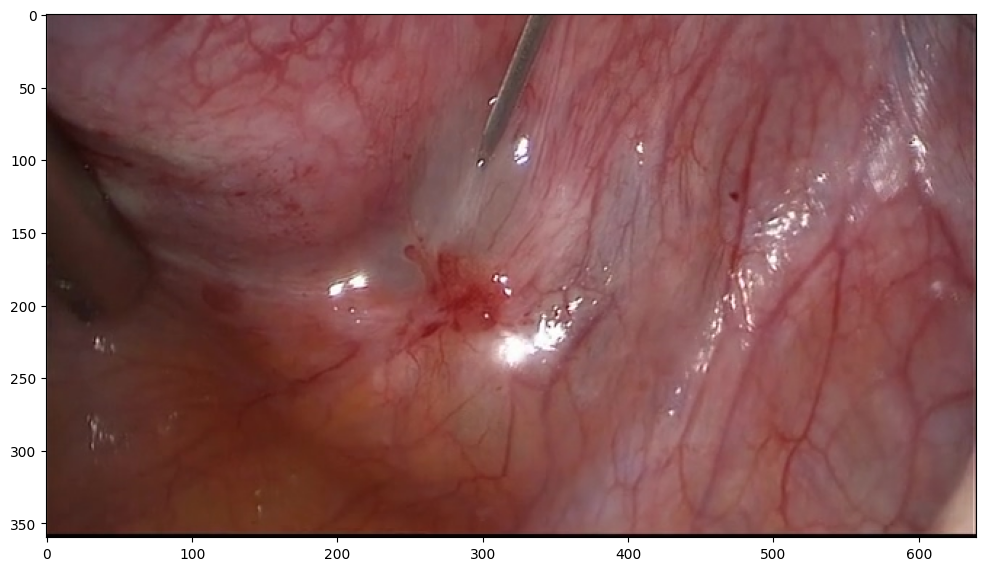

In [48]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('16_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


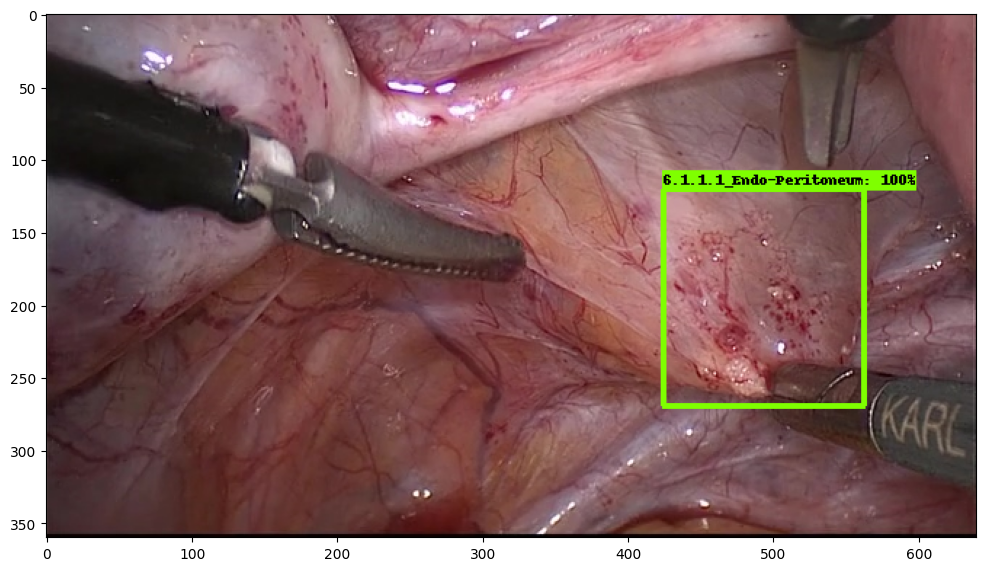

In [49]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('17_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


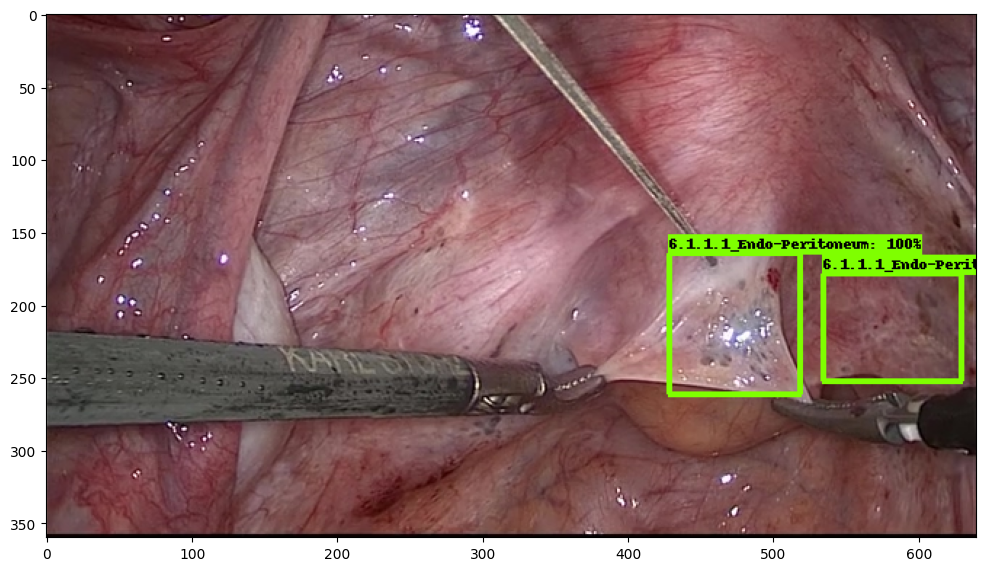

In [77]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('18_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


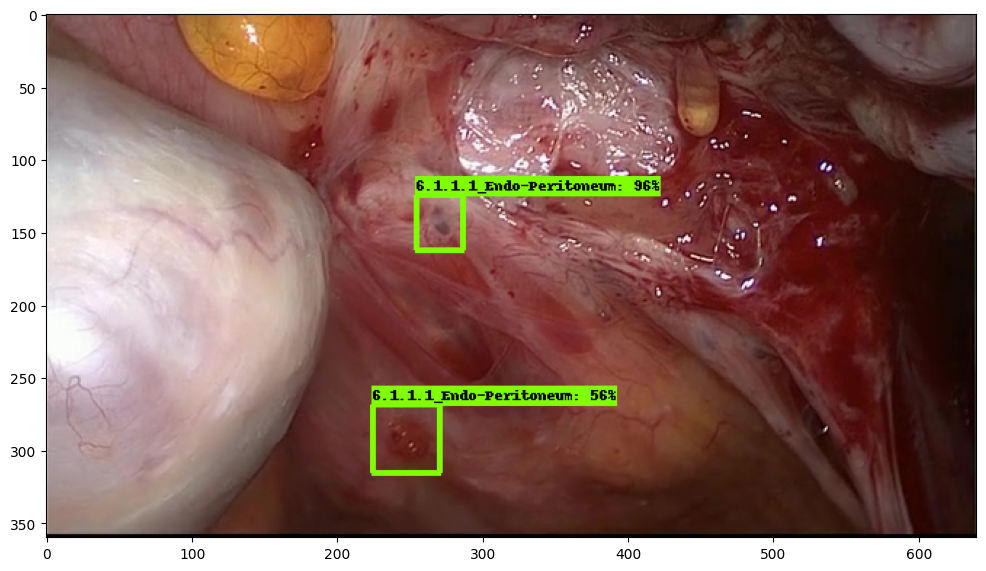

In [81]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('19_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


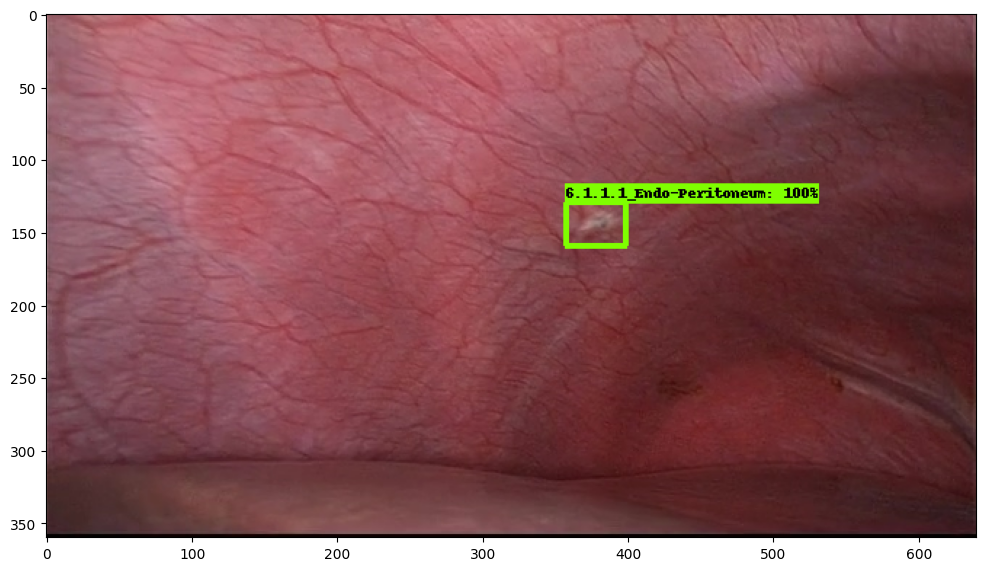

In [84]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('20_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


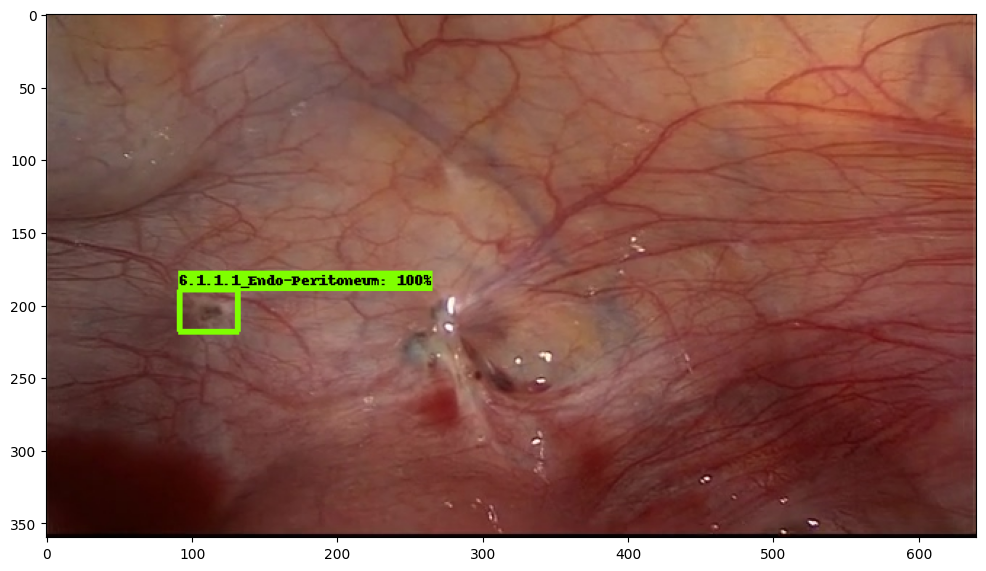

In [83]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('21_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


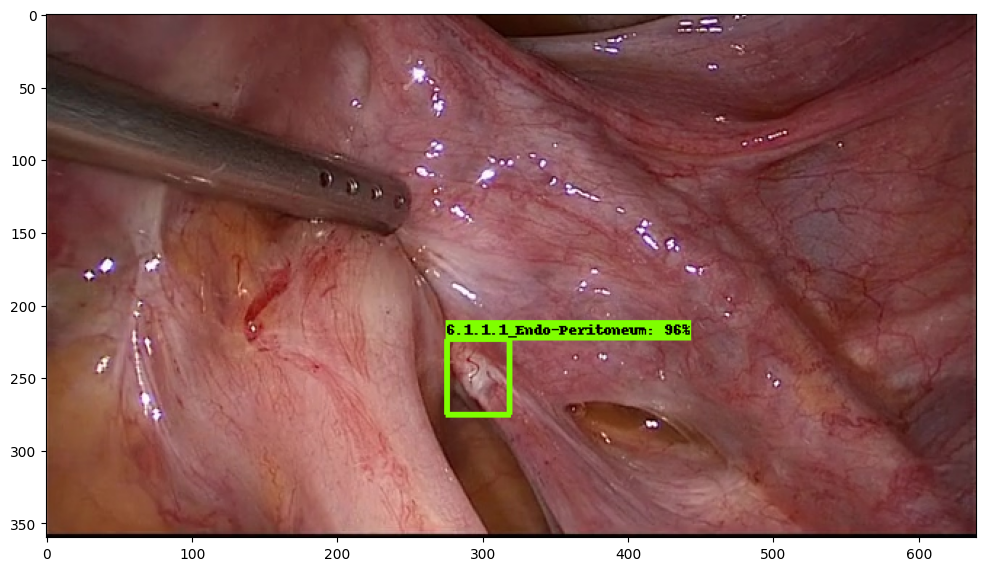

In [86]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('22_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


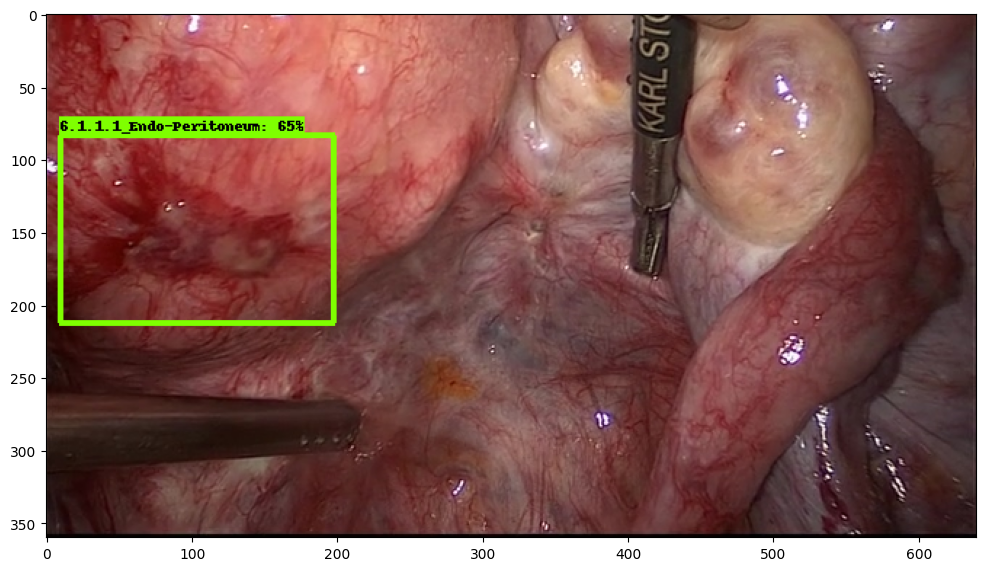

In [88]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('23_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


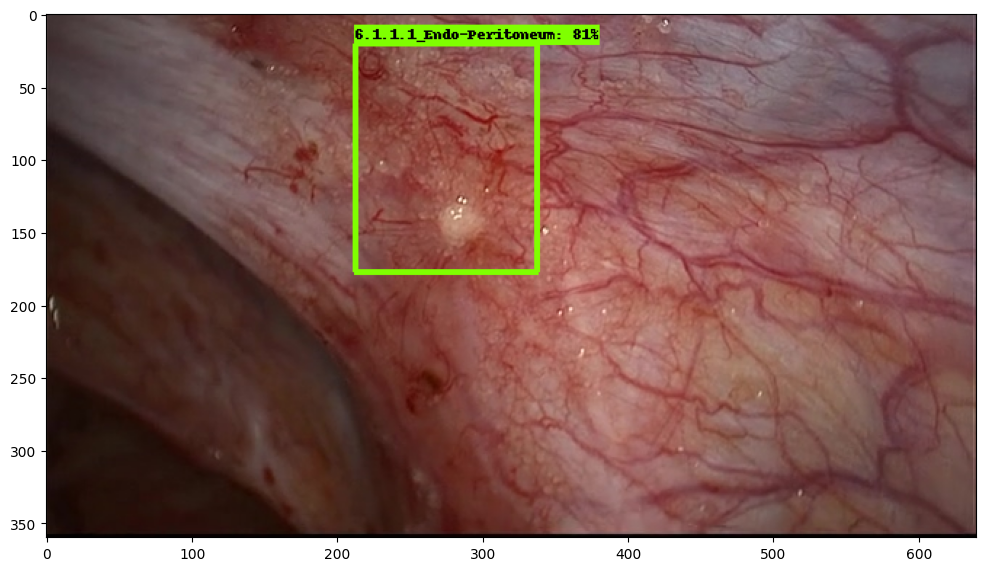

In [95]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('24_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


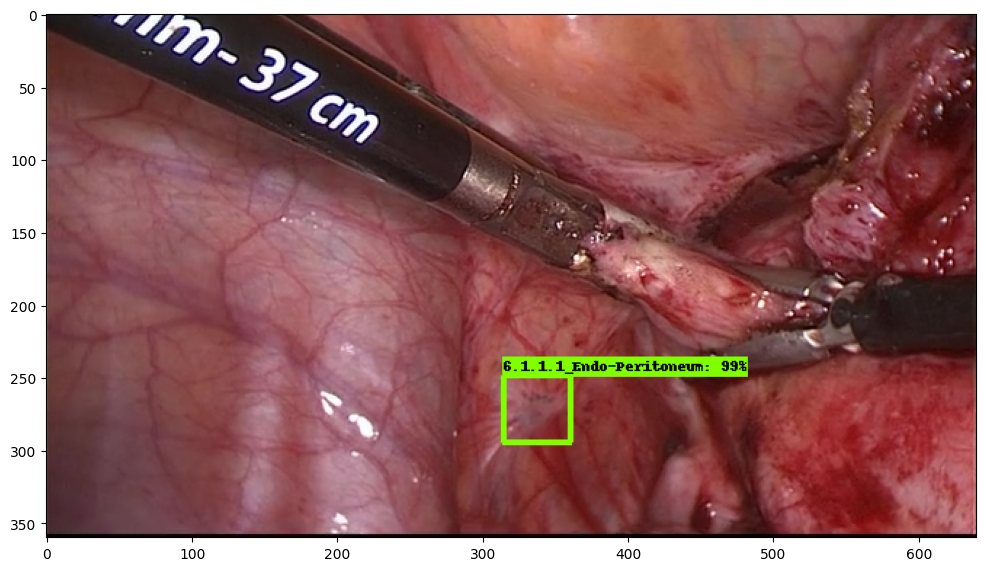

In [99]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('25_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


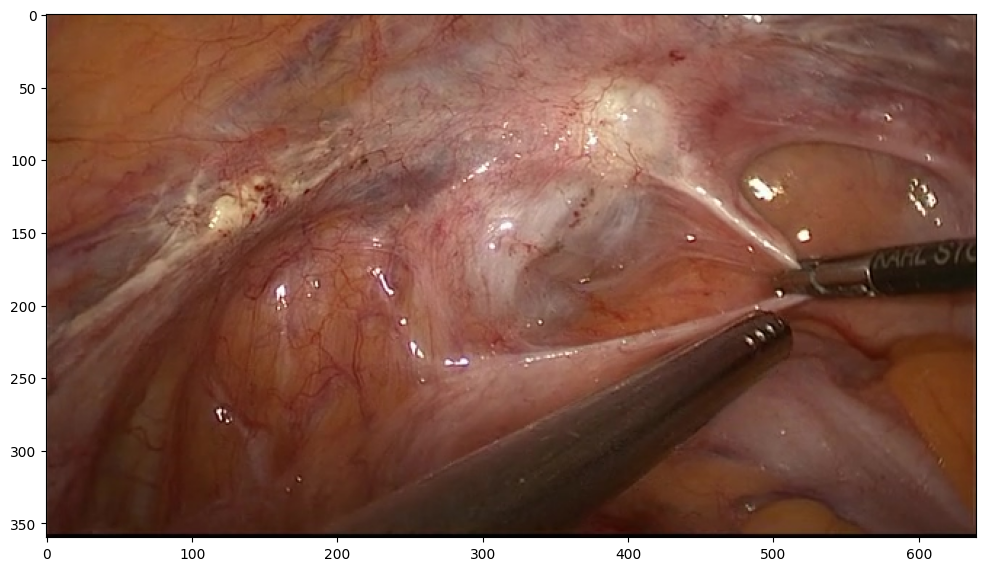

In [113]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('26_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


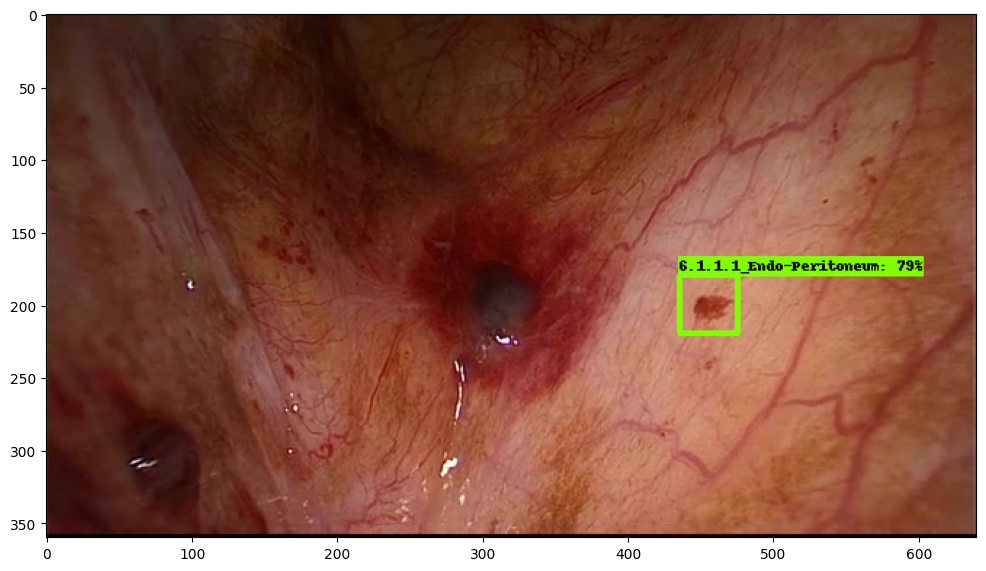

In [136]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('27_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


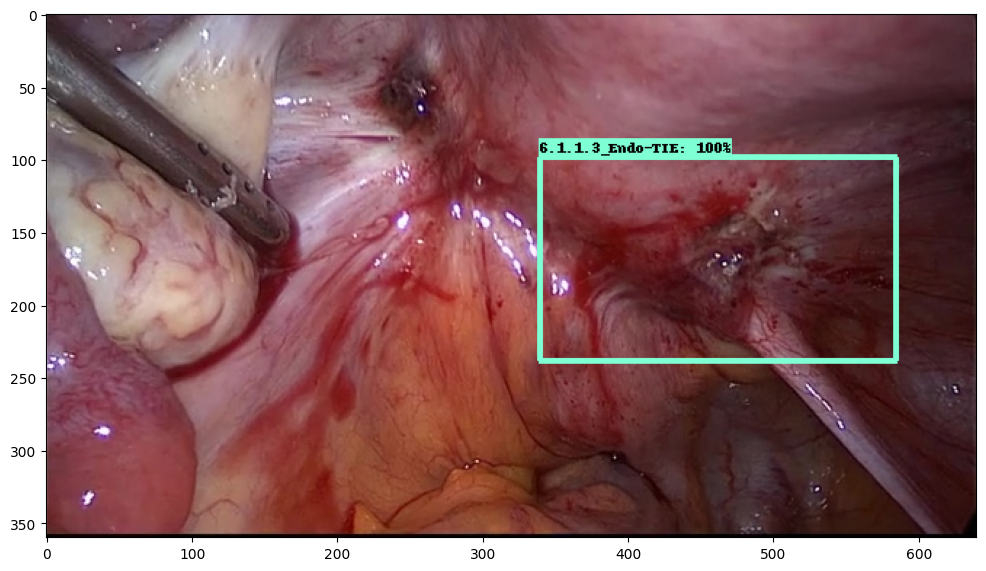

In [140]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('28_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


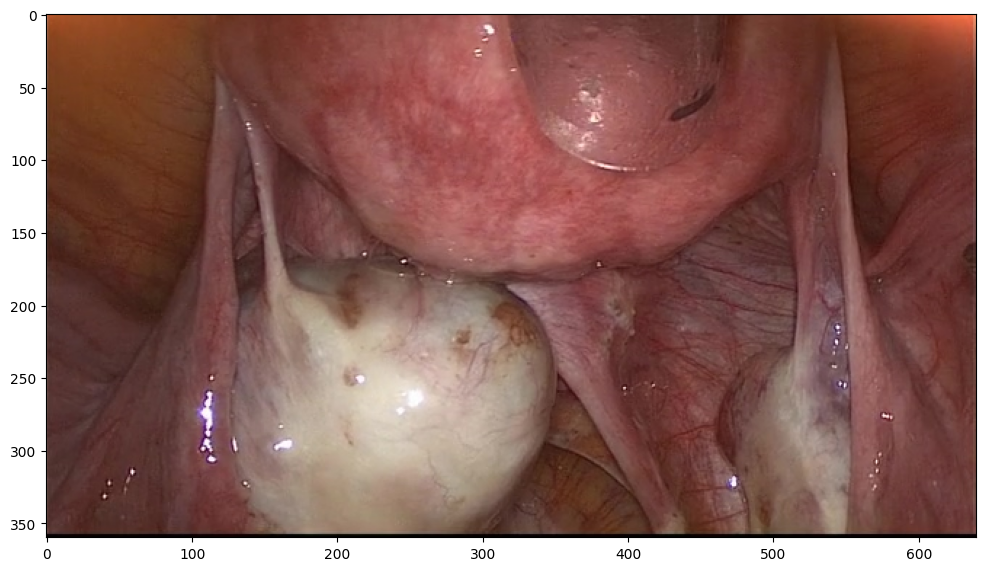

In [143]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('29_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


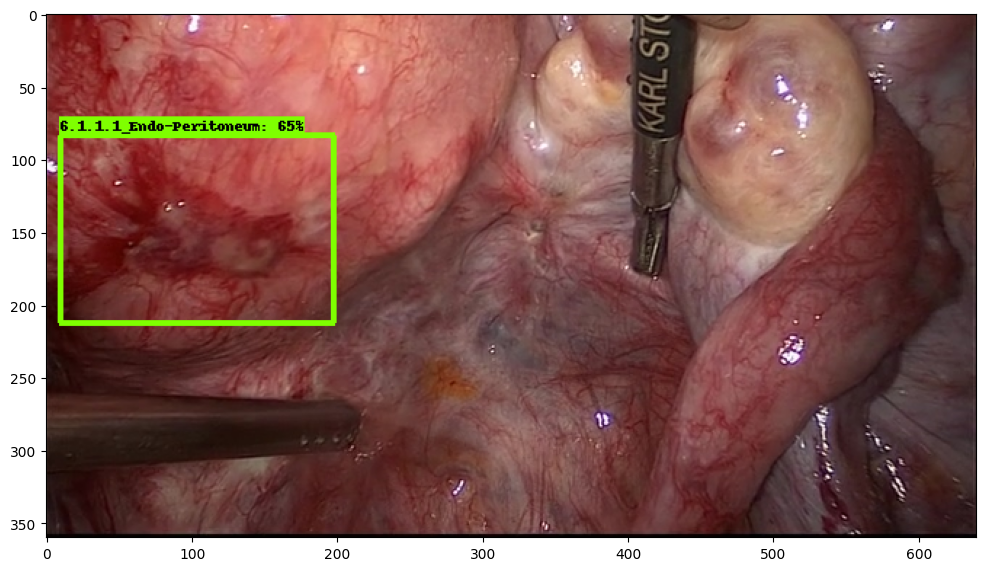

In [220]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('30_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()


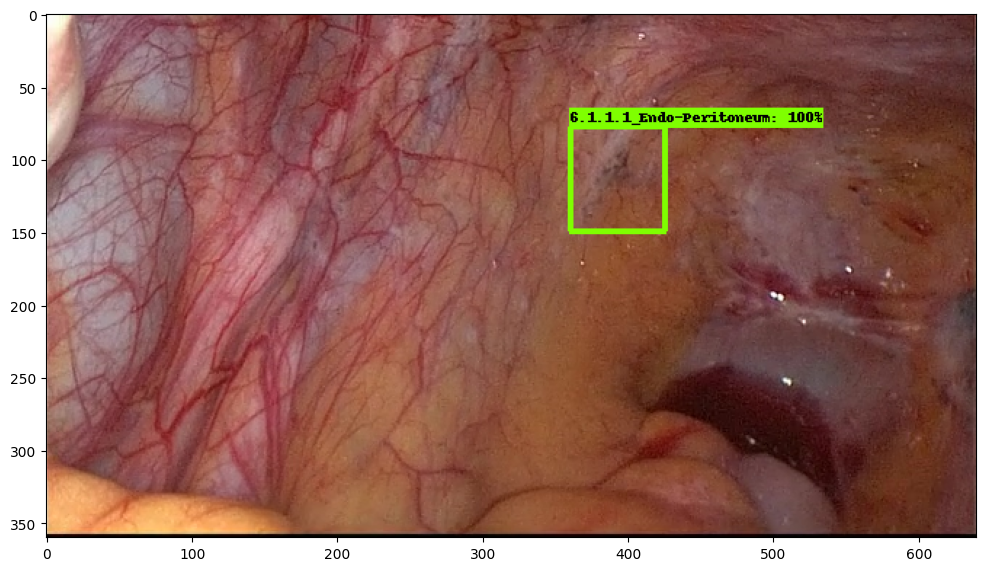

In [221]:
# running detector on test image

TEST_IMAGE_PATHS = glob.glob('/home/759635/Glenda_v1.5_classes/test_frames/*.jpg')
image_path = random.choice(TEST_IMAGE_PATHS)
image_np = load_image_into_numpy_array(image_path)

input_tensor = tf.convert_to_tensor(
    np.expand_dims(image_np, 0), dtype=tf.float32)
detections, predictions_dict, shapes = detect_fn(input_tensor)

label_id_offset = 1
image_np_with_detections = image_np.copy()

viz_utils.visualize_boxes_and_labels_on_image_array(
      image_np_with_detections,
      detections['detection_boxes'][0].numpy(),
      (detections['detection_classes'][0].numpy() + label_id_offset).astype(int),
      detections['detection_scores'][0].numpy(),
      category_index,
      use_normalized_coordinates=True,
      max_boxes_to_draw=200,
      min_score_thresh=.5,
      agnostic_mode=False,
)

plt.figure(figsize=(12,16))
plt.imshow(image_np_with_detections)

# Save the image with bounding boxes and labels
plt.savefig('31_mobilenet.jpg', bbox_inches='tight')

# Show the image
plt.show()
